This notebook demonstrates how to remove watermarks from images using a Convolutional Autoencoder. The process includes preparing the dataset, matching watermarked and clean images, resizing them, and converting them into pixel arrays. It also applies important preprocessing steps such as data augmentation, normalization, and splitting the data for training and testing. A convolutional autoencoder model is then built and trained to learn how to reconstruct clean images from watermarked ones. The notebook ends with testing the model and visualizing the results to compare real and predicted outputs.

Mohammad Umer Mir


Smit Patil


Khizer Ansari

import important libraries

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from keras.models import Model
from keras.layers import Conv2D, MaxPooling2D, Dense, Input, Conv2D, UpSampling2D, BatchNormalization
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping
import cv2
import os
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
import random

Mount Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


Create extraction folder

In [ ]:
# 1. confirm drive and make working folder
!echo "Mounted at /content/drive"
!ls -la /content/drive/MyDrive | sed -n '1,200p'

# make a safe extraction directory
!mkdir -p /content/dataset
!ls -la /content/dataset


Mounted at /content/drive
total 845595
-rw------- 1 root root       174 Sep 28 09:36 10167_OSSP_Exp8.gdoc
-rw------- 1 root root   2415910 Sep 24 06:24 10169_Experiment7-kmean.docx
-rw------- 1 root root    645941 Oct  4  2024 10192.docx
-rw------- 1 root root       174 Jul 31 17:43  10200_dlrl_exp_1.gdoc
-rw------- 1 root root       174 Sep 26 01:49 10200_DLRL_Exp-3.gdoc
-rw------- 1 root root       174 Aug 11 13:36 10200_E (1).V_ISE1.gdoc
-rw------- 1 root root       174 Aug 11 13:36 10200_E (2).V_ISE1.gdoc
-rw------- 1 root root       174 Aug 11 13:42 10200_E.V_ISE1.gdoc
-rw------- 1 root root    549779 Oct 28 07:00 10200_exp10.docx
-rw------- 1 root root       174 Nov 10 11:11 10200_exp4_TCSCC.gdoc
-rw------- 1 root root       174 Jul 24 09:25 10200_Experiment2_Shell_Systemcalls.gdoc
-rw------- 1 root root       174 Sep 22 01:55 10200_Experiment 7.gdoc
-rw------- 1 root root   2029294 Sep 24 06:53 10200_Experiment7-kmean.docx
-rw------- 1 root root       174 Sep 26 09:59 10200_Expe

Unzip Dataset

In [ ]:
ZIP_PATH = "/content/drive/MyDrive/Dataset.zip"

# Check file exists
!echo "Checking for file at: {ZIP_PATH}"
!ls -lh "{ZIP_PATH}"

# Make extraction folder
!mkdir -p /content/dataset

# Extract ZIP
!unzip -q "{ZIP_PATH}" -d /content/dataset

# Show extracted structure
!echo "---- Extracted Files ----"
!ls -R /content/dataset | sed -n '1,200p'


Checking for file at: /content/drive/MyDrive/Dataset.zip
-rw------- 1 root root 699M Nov 19 10:57 /content/drive/MyDrive/Dataset.zip
---- Extracted Files ----
/content/dataset:
wm-nowm

/content/dataset/wm-nowm:
train
valid

/content/dataset/wm-nowm/train:
no-watermark
watermark

/content/dataset/wm-nowm/train/no-watermark:
adler-bird-bird-of-prey-raptor-56865.jpeg
africa-animal-big-carnivore-41178.jpeg
african-american-slavery-man-woman-161890.jpeg
african-grey-parrot-parrot-bird-plumage-162078.jpeg
africa-south-africa-wild-nature-67553.jpeg
alps-tree-snow-nature-landscape-flowers-grass.jpg
alsatian-black-eyes-german-shepherd-56034.jpeg
amur-tiger-tiger-captivity-striped-2264556.jpeg
animal-africa-wilderness-zoo.jpg
animal-ara-macao-beak-bird-40984.jpeg
animal-bird-hornbill-helmet-hornbill-67225.jpeg
animal-cat-kitten-funny-56857.jpeg
animal-close-up-view-africa-wilderness.jpg
animal-cute-fur-white.jpg
animal-cute-kitten-cat.jpg
animal-dog-pet-cute.jpg
animal-dog-pet-window.jpg
animal

In [ ]:
wm_dir = "/content/dataset/wm-nowm/wm"
nowm_dir = "/content/dataset/wm-nowm/nowm"


# Data Processing
We want to make sure that the images in the non-watermarked and watermarked sets are the same. This can be achieved by checking if they have the same file name.

In [ ]:
def takeFileName(filedir): # remove just file name from directory and return
    # filename = np.array(filedir.split('/'))[-1].split('.')[0] # take out the name, isolate the jpeg, then return the name
    filename = np.array(filedir.split('/'))[-1] # take out the name, then return the name
    # print(filename)
    return filename

In [ ]:
def matchFileNames(watermarkedarr, nonwatermarkedarr, dname_wm, dname_nwm):
    sortedwmarr = np.array([])
    sortednwmarr = np.array([])

    wmarr = list(watermarkedarr)
    nwmarr = list(nonwatermarkedarr)

    length = len(watermarkedarr) if len(watermarkedarr) >= len(nonwatermarkedarr) else len(nonwatermarkedarr)

    for pos in range(length):
        try:
            if length == len(watermarkedarr): # more images in watermarked array
                exist_nwm = nwmarr.index(wmarr[pos])
                sortedwmarr = np.append(sortedwmarr, dname_wm + watermarkedarr[pos]) # this is the iterable
                sortednwmarr = np.append(sortednwmarr, dname_nwm + nonwatermarkedarr[exist_nwm]) # this is the match
            elif length == len(nonwatermarkedarr): # more images in nonwatermarked array
                exist_wm = wmarr.index(nwmarr[pos])
                sortedwmarr = np.append(sortedwmarr, dname_wm + watermarkedarr[exist_wm]) # this is the match
                sortednwmarr = np.append(sortednwmarr, dname_nwm + nonwatermarkedarr[pos]) # this is the iterable
        except ValueError:
            continue
    return sortedwmarr, sortednwmarr

In [ ]:
# Sort the watermarked and non watermarked images into parallel arrays so NN will use it better

train_path_watermarked_images = '/content/dataset/wm-nowm/train/watermark/'
train_path_nonwatermarked_images = '/content/dataset/wm-nowm/train/no-watermark/'

tp_watermarked = np.array([])  # array with watermarked image names
tp_nonwatermarked = np.array([])  # array with nonwatermarked image names

for root, dirs, files in os.walk(train_path_watermarked_images, topdown=True):
    for file in files:
        tp_watermarked = np.append(tp_watermarked, takeFileName(file))

for root, dirs, files in os.walk(train_path_nonwatermarked_images, topdown=True):
    for file in files:
        tp_nonwatermarked = np.append(tp_nonwatermarked, takeFileName(file))

tp_watermarked_sorted, tp_nonwatermarked_sorted = matchFileNames(
    tp_watermarked,
    tp_nonwatermarked,
    train_path_watermarked_images,
    train_path_nonwatermarked_images
)

# VALIDATION PATHS
valid_path_watermarked_images = '/content/dataset/wm-nowm/valid/watermark/'
valid_path_nonwatermarked_images = '/content/dataset/wm-nowm/valid/no-watermark/'

vp_watermarked = np.array([])
vp_nonwatermarked = np.array([])

for root, dirs, files in os.walk(valid_path_watermarked_images, topdown=True):
    for file in files:
        vp_watermarked = np.append(vp_watermarked, takeFileName(file))

for root, dirs, files in os.walk(valid_path_nonwatermarked_images, topdown=True):
    for file in files:
        vp_nonwatermarked = np.append(vp_nonwatermarked, takeFileName(file))

vp_watermarked_sorted, vp_nonwatermarked_sorted = matchFileNames(
    vp_watermarked,
    vp_nonwatermarked,
    valid_path_watermarked_images,
    valid_path_nonwatermarked_images
)


In [ ]:
# dimension to resize to
width = 128 # only certain dimensions work due to UpSampling (128x128 works, 148x148 works)
height = 128
dim = (width, height) # set the dimensions

def createPixelArr(files):
    data = []
    for image in files:
        try: # take each image and use imread to get the pixel values in a matrix
            img_arr = cv2.imread(image, cv2.IMREAD_COLOR)
            resized_arr = cv2.resize(img_arr, (width, height)) # rescale the image so every image is of the same dimension
            data.append(resized_arr) # add the matrix of pixel values
        except Exception as e:
            print(e) # some error thrown in imread or resize
    return np.array(data)

train_wms_pixVals = createPixelArr(tp_watermarked_sorted)
train_nwms_pixVals = createPixelArr(tp_nonwatermarked_sorted)

val_wms_pixVals = createPixelArr(vp_watermarked_sorted)
val_nwms_pixVals = createPixelArr(vp_nonwatermarked_sorted) # make ndarrays

In [ ]:
print("WM images array:", type(train_wms_pixVals), len(train_wms_pixVals))
print("No-WM images array:", type(train_nwms_pixVals), len(train_nwms_pixVals))


WM images array: <class 'numpy.ndarray'> 1743
No-WM images array: <class 'numpy.ndarray'> 1743


In [ ]:
# TODO use sklearn to split tp_wms_pixVals, tp_nwms_pixVals into training and testing sets
# use variables names: X_train, y_train, X_test, y_test
# 80% training, 20% testing, amount of shuffling applied
X_train, X_test, y_train, y_test = train_test_split(train_wms_pixVals, train_nwms_pixVals, train_size=0.8, random_state=1)

Garbage collection - free up RAM

In [ ]:
train_wms_pixVals = 0
train_nwms_pixVals = 0
val_wms_pixVals = 0
val_nwms_pixVals = 0

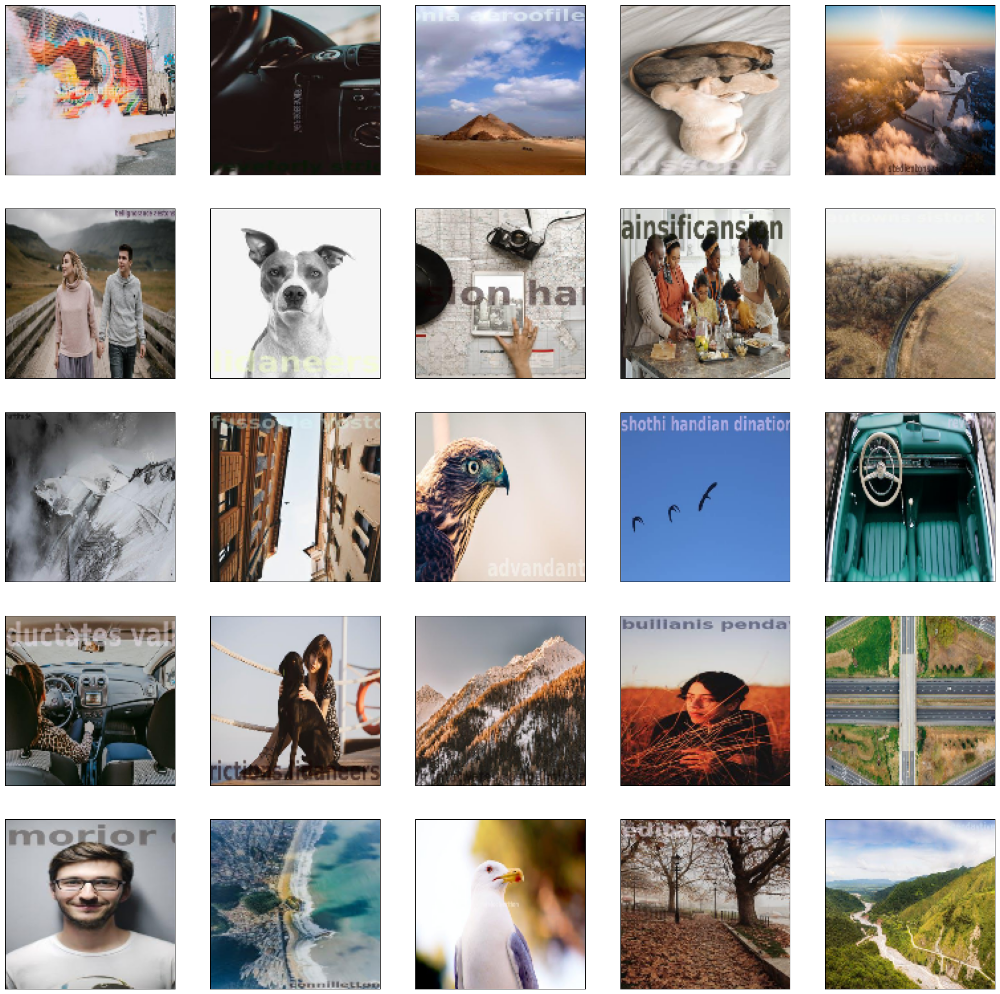

In [ ]:
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(X_test[i], cv2.COLOR_BGR2RGB))
plt.show()

# Methods for data augmentation

In [ ]:
# Functions to data augment images

def data_augmentation(inputImage): # run image through all augmentation methods
    return randomContrast(randomBrightness(inputImage)).numpy()
    # return randomCrop(randomFlip(inputImage)) # use augmentation methods without messing with colour

def randomFlip(pic): # flips the image up and down before left and right at random
    return tf.image.random_flip_up_down(tf.image.random_flip_left_right(pic, 1), 1)

# def randomCrop(pic): # crops the image from a randomly defined width and height, that are under the intial image width and height
#     return tf.image.random_crop(pic, size=[random.randint(75,width), random.randint(75,height), 3], seed=None)

def randomBrightness(pic): # makes the image a random brightness from 1% to 20%
    return tf.image.random_brightness(pic, random.uniform(0.01, 0.2), 1)

def randomContrast(pic): # contrasts the image from 5% to 50%
    return tf.image.random_contrast(pic, 0.2, 0.7, 1)

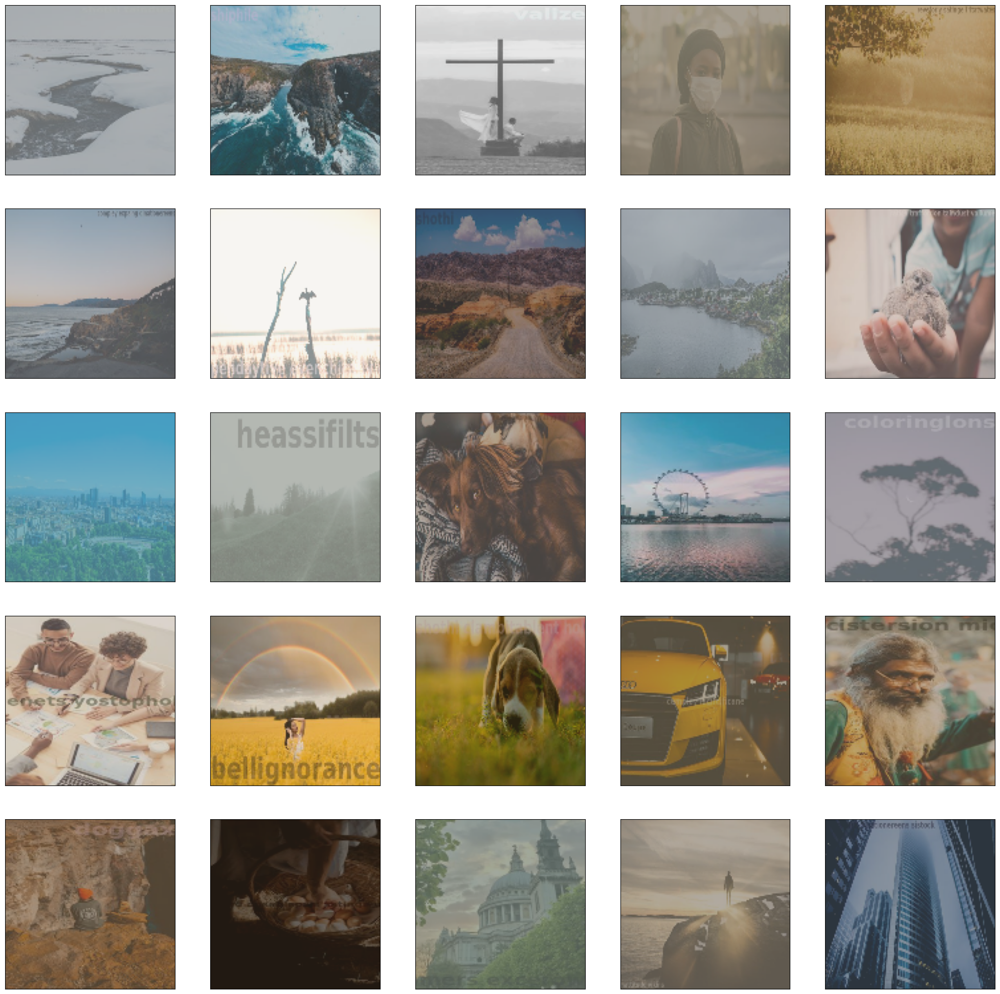

In [ ]:
# Output Tensorflow data augmented images
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    augmented_image = data_augmentation(X_train[random.randint(1, len(X_train))]) # send 25 images into data augmentation
    plt.imshow(cv2.cvtColor(augmented_image, cv2.COLOR_BGR2RGB)) # not using cv2 as it messed up the code
plt.show()

In [ ]:
#apply data augmentation to the X_train and y_train

data_augmented_X = []
data_augmented_y = []

for image in X_train:
    data_augmented_X.append(data_augmentation(image))

for image in y_train:
    data_augmented_y.append(data_augmentation(image))

# Data Augmentation Pictures

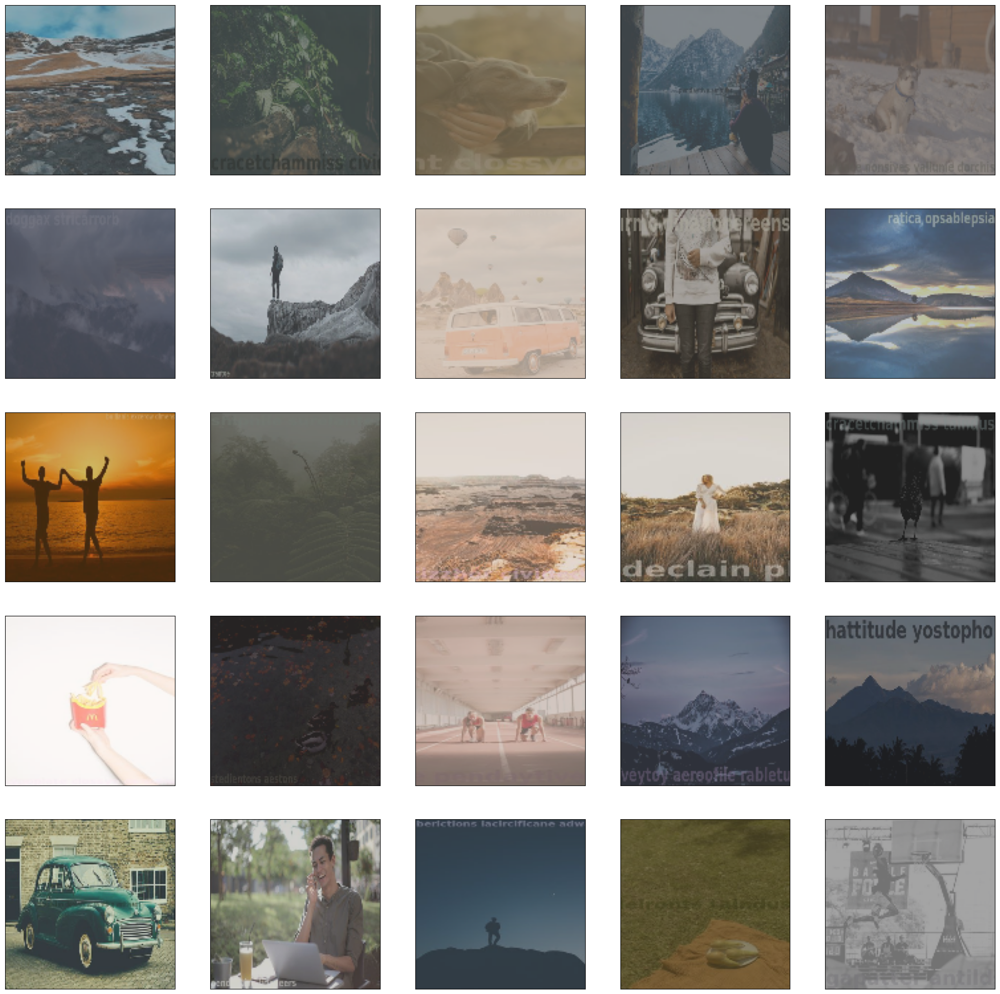

In [ ]:
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(data_augmented_X[i], cv2.COLOR_BGR2RGB))
plt.show()

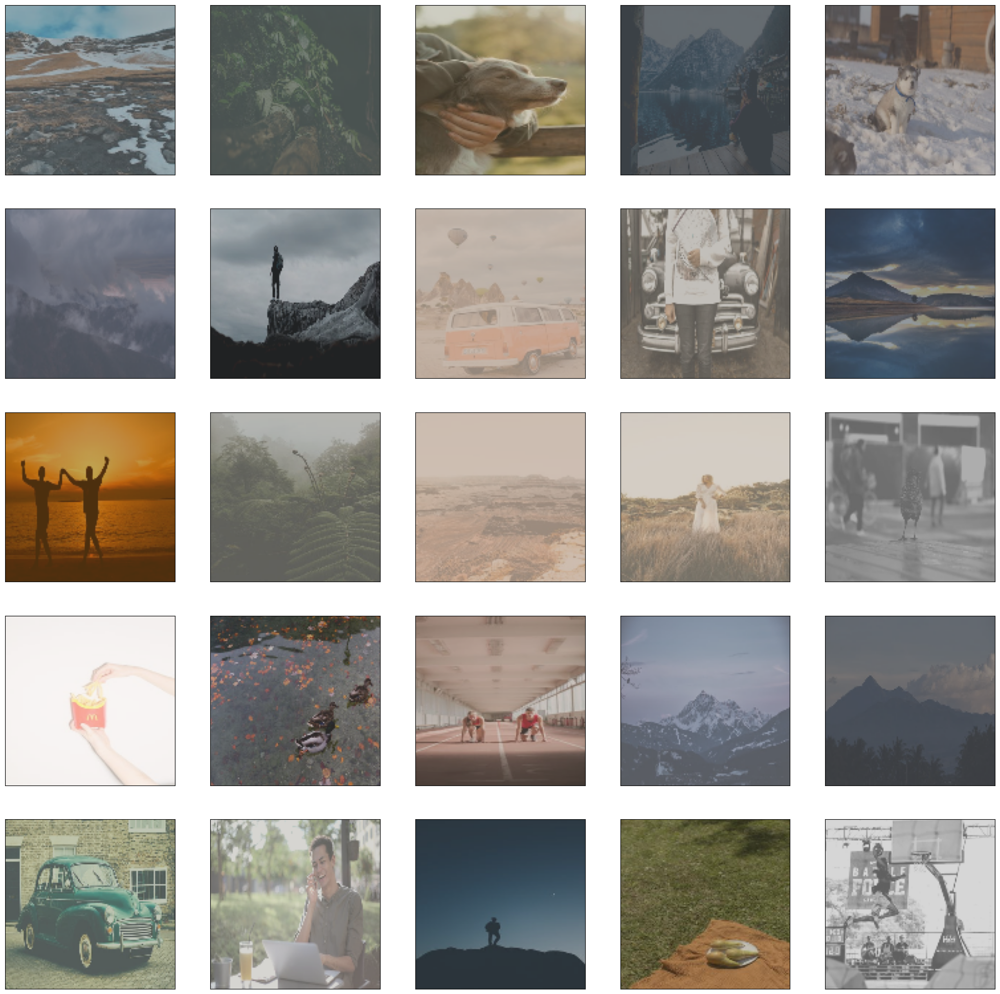

In [ ]:
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(data_augmented_y[i], cv2.COLOR_BGR2RGB))
plt.show()

Combine the augmented images with the training sets

In [ ]:
X_train = np.append(X_train, data_augmented_X, axis=0)
y_train = np.append(y_train, data_augmented_y, axis=0)

Normalizet the values between 0 and 1

In [ ]:
# normalize
X_train = X_train / 255
y_train = y_train / 255
X_test = X_test / 255
y_test = y_test / 255

# Base convolutional autoencoder

In [ ]:
def create_model(width, height):
    from keras.models import Model
    from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D

    input_img = Input(shape=(height, width, 3))

    # ---------- Encoder ----------
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
    x = MaxPooling2D((2, 2), padding='same')(x)  # 64x64

    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)  # 32x32

    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    encoded = MaxPooling2D((2, 2), padding='same')(x)  # 16x16

    # ---------- Decoder ----------
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)  # 32x32

    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)  # 64x64

    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)  # 128x128

    decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

    model = Model(input_img, decoded)
    model.compile(optimizer='adam', loss='mse')

    return model

In [ ]:
watermark_auto_encoder = create_model(width, height)
early_stop = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True)
history = watermark_auto_encoder.fit(X_train, y_train, batch_size=8, epochs=50, callbacks=[early_stop])

Epoch 1/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 15s 21ms/step - loss: 0.0335
Epoch 2/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - loss: 0.0155
Epoch 3/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - loss: 0.0138
Epoch 4/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - loss: 0.0137
Epoch 5/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0131
Epoch 6/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - loss: 0.0121
Epoch 7/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - loss: 0.0123
Epoch 8/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - loss: 0.0121
Epoch 9/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - loss: 0.0115
Epoch 10/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - loss: 0.0115
Epoch 11/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - loss: 0.0107
Epoch 12/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - loss: 0.0108
Epoch 13/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - loss: 0.0106
Epoch 14/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - loss: 0.0110
Epoch 15/50
349/349 ━━━━━━━━━━━━━━━━━━━━ 

# Results of the convolutional autoencoder model

In [ ]:
result = watermark_auto_encoder.predict(X_test)
watermark_auto_encoder.evaluate(X_test, result)

11/11 ━━━━━━━━━━━━━━━━━━━━ 4s 185ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step - loss: 0.0000e+00


0.0

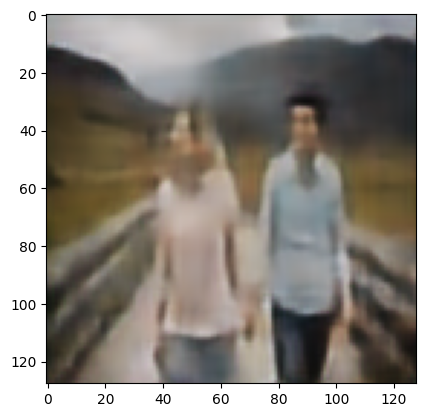

In [ ]:
plt.imshow(cv2.cvtColor(result[5], cv2.COLOR_BGR2RGB))

# Actual vs Predictions

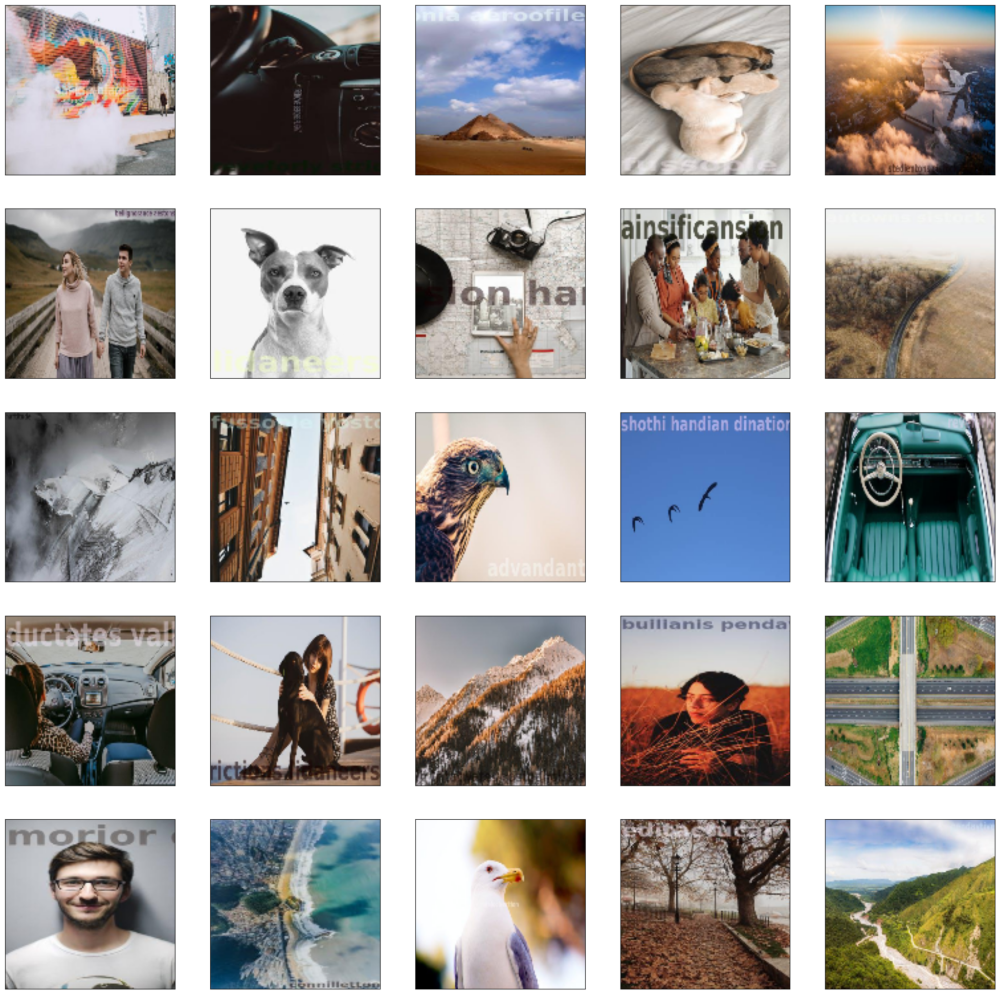

In [ ]:
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(X_test[i].astype('float32'), cv2.COLOR_BGR2RGB))
plt.show()

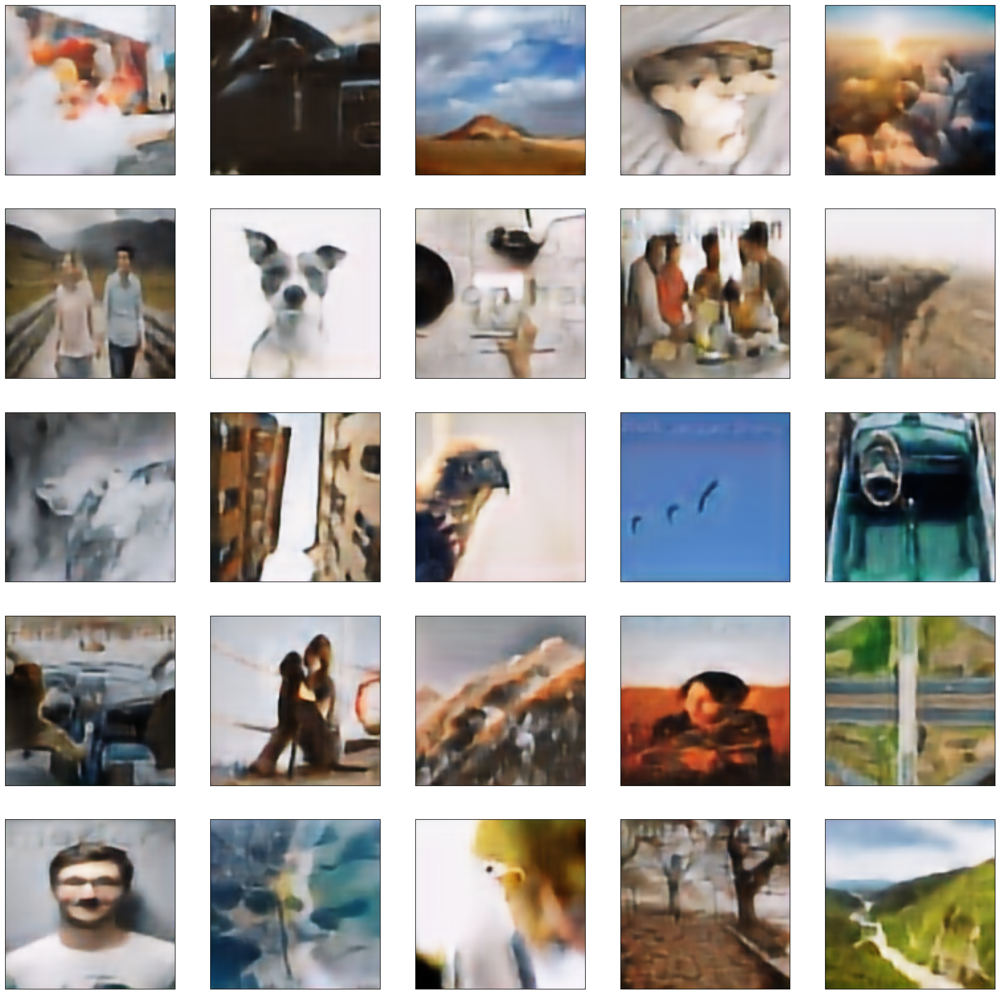

In [ ]:
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(result[i], cv2.COLOR_BGR2RGB))
plt.show()